In [1]:
# NBVAL_SKIP
# Only run this cell if on google colab
import os

if "COLAB_RELEASE_TAG" in os.environ:
    !pip install -U https://github.com/conda-incubator/condacolab/archive/cuda-version-12.tar.gz
    import condacolab

    condacolab.install_mambaforge()
    !wget -q https://raw.githubusercontent.com/OpenFreeEnergy/konnektor/main/examples/environment.yaml
    !mamba env update -q --name=base --file=environment.yaml

    from google.colab import output
    
    output.enable_custom_widget_manager()



## Fetching the input data and building the `AtomMapper` and `AtomMappingScorer` classes

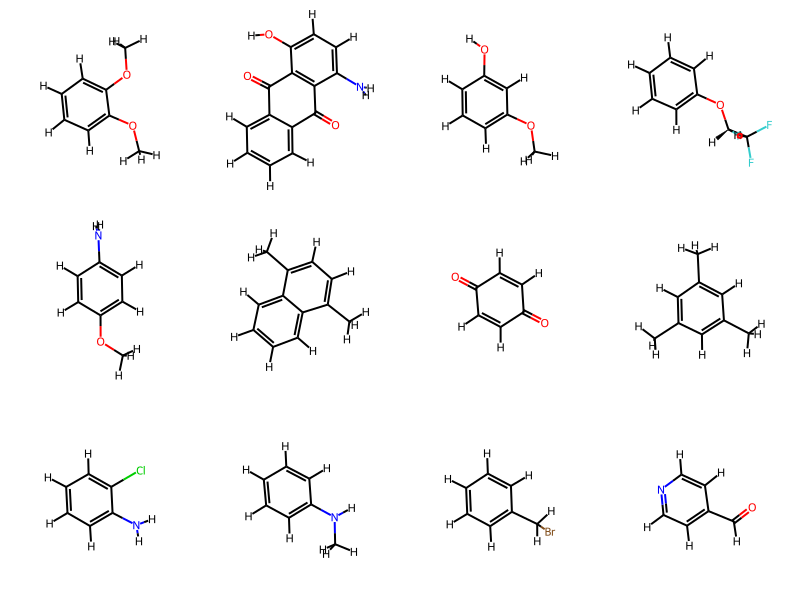

In [2]:
# Getting Data
from rdkit import Chem
from konnektor.data import get_benzene_ligands

rw_components = get_benzene_ligands()
rw_components = list(
    filter(lambda x: not x.name in ["lig_2", "lig_3", "lig_4", "lig_7"], rw_components)
)
Chem.Draw.MolsToGridImage([c.to_rdkit() for c in rw_components], molsPerRow=4)

In [3]:
# Load AtomMapper and Scorer
from kartograf import KartografAtomMapper, MappingRMSDScorer

mapper = KartografAtomMapper()
scorer = MappingRMSDScorer()

ModuleNotFoundError: No module named 'kartograf'

## Construct __Cyclic Network Layout__
We build a `CyclicNetworkGenerator` by passing the `AtomMapper` and `AtomMappingScorer` from Kartograf and use the generator with the components.

In [4]:
from konnektor.network_planners import CyclicNetworkGenerator

network_planner = CyclicNetworkGenerator(
    mappers=mapper, scorer=scorer, n_processes=1
)

cyclic_network_rw = network_planner(rw_components)
cyclic_network_rw.name = "Real World Cyclic Network"
cyclic_network_rw

NameError: name 'mapper' is not defined

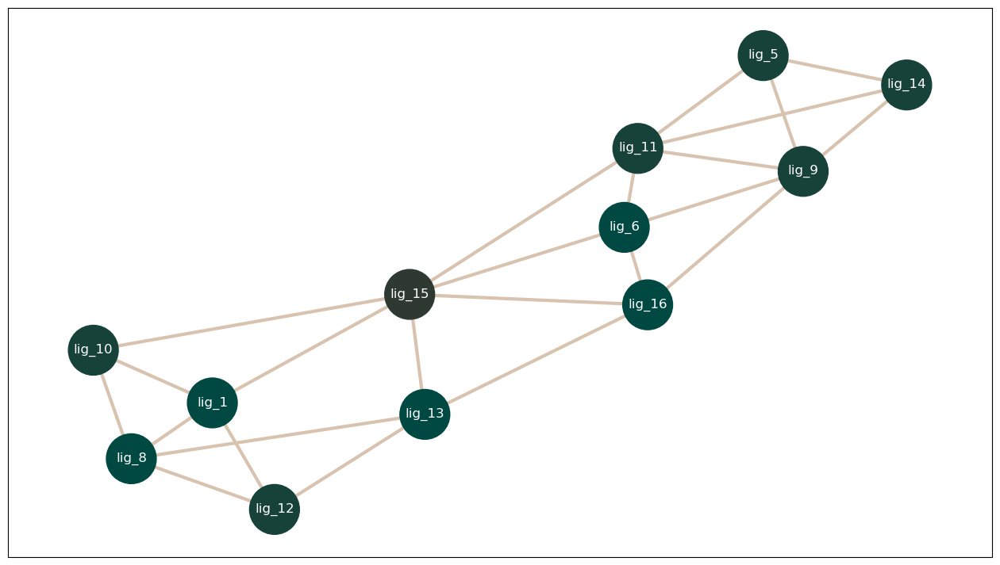

In [5]:
# NBVAL_SKIP
from konnektor.visualization import draw_ligand_network
draw_ligand_network(cyclic_network_rw);

In [6]:
# NBVAL_SKIP
from konnektor.visualization import draw_network_widget

draw_network_widget(cyclic_network_rw, show_molecules=True, show_mappings=True);

interactive(children=(Dropdown(description='layout', index=4, options=('dagre', 'cola', 'breadthfirst', 'conce…